## Project Statement
The Film Junky Union, a new edgy community for classic movie enthusiasts, is developing a system for filtering and categorizing movie reviews. The goal is to train a model to automatically detect negative reviews.

You'll be using a dataset of IMBD movie reviews with polarity labelling to build a model for classifying positive and negative reviews.

It will need to have an F1 score of at least 0.85.

### Initialization

In [1]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [ ]:
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import math
import numpy as np
import pandas as pd

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.figure_factory import create_distplot
from plotly.subplots import make_subplots


from tqdm.auto import tqdm

from sklearn.metrics import confusion_matrix, classification_report, auc
import sklearn.cluster as cluster
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score, RepeatedStratifiedKFold
from sklearn.model_selection import train_test_split, RandomizedSearchCV
import time

In [3]:
import torch
import transformers

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'png'
# the next line provides graphs of better quality on HiDPI screens
%config InlineBackend.figure_format = 'retina'

# plt.style.available
plt.style.use('seaborn-v0_8-pastel')

In [ ]:
# this is to use progress_apply, read more at https://pypi.org/project/tqdm/#pandas-integration
tqdm.pandas()

#### data import

In [ ]:
df_reviews = pd.read_csv('C:/Users/gsrav/Desktop/imdb_reviews.tsv', sep='\t', dtype={'votes': 'Int64'})

#### data review

In [8]:
df_reviews.shape

(47331, 17)

In [9]:
df_reviews.columns

Index(['tconst', 'title_type', 'primary_title', 'original_title', 'start_year',
       'end_year', 'runtime_minutes', 'is_adult', 'genres', 'average_rating',
       'votes', 'review', 'rating', 'sp', 'pos', 'ds_part', 'idx'],
      dtype='object')

In [10]:
df_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47331 entries, 0 to 47330
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   tconst           47331 non-null  object 
 1   title_type       47331 non-null  object 
 2   primary_title    47331 non-null  object 
 3   original_title   47331 non-null  object 
 4   start_year       47331 non-null  int64  
 5   end_year         47331 non-null  object 
 6   runtime_minutes  47331 non-null  object 
 7   is_adult         47331 non-null  int64  
 8   genres           47331 non-null  object 
 9   average_rating   47329 non-null  float64
 10  votes            47329 non-null  Int64  
 11  review           47331 non-null  object 
 12  rating           47331 non-null  int64  
 13  sp               47331 non-null  object 
 14  pos              47331 non-null  int64  
 15  ds_part          47331 non-null  object 
 16  idx              47331 non-null  int64  
dtypes: Int64(1),

In [11]:
display(df_reviews)

,tconst,title_type,primary_title,original_title,start_year,end_year,runtime_minutes,is_adult,genres,average_rating,votes,review,rating,sp,pos,ds_part,idx
0,tt0068152,movie,$,$,1971,\N,121,0,"Comedy,Crime,Drama",6.3,2218,The pakage implies that Warren Beatty and Gold...,1,neg,0,train,8335
1,tt0068152,movie,$,$,1971,\N,121,0,"Comedy,Crime,Drama",6.3,2218,How the hell did they get this made?! Presenti...,1,neg,0,train,8336
2,tt0313150,short,'15','15',2002,\N,25,0,"Comedy,Drama,Short",6.3,184,There is no real story the film seems more lik...,3,neg,0,test,2489
3,tt0313150,short,'15','15',2002,\N,25,0,"Comedy,Drama,Short",6.3,184,Um .... a serious film about troubled teens in...,7,pos,1,test,9280
4,tt0313150,short,'15','15',2002,\N,25,0,"Comedy,Drama,Short",6.3,184,I'm totally agree with GarryJohal from Singapo...,9,pos,1,test,9281
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47326,tt0068398,tvEpisode,Étude in Black,Étude in Black,1972,\N,97,0,"Crime,Drama,Mystery",7.7,2254,This is another of my favorite Columbos. It sp...,10,pos,1,test,6038
47327,tt0223503,tvMovie,Îhatôbu gensô: KENjI no haru,Îhatôbu gensô: KENjI no haru,1996,\N,55,0,"Animation,Biography,Drama",7.3,278,Talk about being boring! I got this expecting ...,4,neg,0,test,989
47328,tt0223503,tvMovie,Îhatôbu gensô: KENjI no haru,Îhatôbu gensô: KENjI no haru,1996,\N,55,0,"Animation,Biography,Drama",7.3,278,"I never thought I'd say this about a biopic, b...",8,pos,1,test,4163
47329,tt0223503,tvMovie,Îhatôbu gensô: KENjI no haru,Îhatôbu gensô: KENjI no haru,1996,\N,55,0,"Animation,Biography,Drama",7.3,278,Spirit and Chaos is an artistic biopic of Miya...,9,pos,1,test,4164


In [12]:
df_reviews.describe()

,start_year,is_adult,average_rating,votes,rating,pos,idx
count,47331.000000,47331.000000,47329.000000,47329.0,47331.000000,47331.000000,47331.000000
mean,1989.631235,0.001732,5.998278,25562.917323,5.484608,0.498954,6279.697999
std,19.600364,0.041587,1.494289,83670.039163,3.473109,0.500004,3605.702545
min,1894.000000,0.000000,1.400000,9.0,1.000000,0.000000,0.000000
25%,1982.000000,0.000000,5.100000,827.0,2.000000,0.000000,3162.000000
50%,1998.000000,0.000000,6.300000,3197.0,4.000000,0.000000,6299.000000
75%,2004.000000,0.000000,7.100000,13974.0,9.000000,1.000000,9412.000000
max,2010.000000,1.000000,9.700000,1739448.0,10.000000,1.000000,12499.000000


In [13]:
df_reviews.nunique()

tconst              6648
title_type            10
primary_title       6555
original_title      6562
start_year           107
end_year              60
runtime_minutes      249
is_adult               2
genres               585
average_rating        83
votes               3748
review             47240
rating                 8
sp                     2
pos                    2
ds_part                2
idx                12500
dtype: int64

In [14]:
df_reviews[['votes','rating', 'average_rating', 'is_adult', 'pos']].corr(method='pearson')

,votes,rating,average_rating,is_adult,pos
votes,1.000000,0.054170,0.229570,-0.012193,0.052365
rating,0.054170,1.000000,0.509180,0.004866,0.941231
average_rating,0.229570,0.509180,1.000000,-0.015592,0.481103
is_adult,-0.012193,0.004866,-0.015592,1.000000,0.005168
pos,0.052365,0.941231,0.481103,0.005168,1.000000


In [15]:
print("There are {} observations and {} features in this dataset. \n".format(df_reviews.shape[0],df_reviews.shape[1]))

print("There are {} types of titles in this dataset such as {}... \n".format(len(df_reviews.title_type.unique()),
                                                                           ", ".join(df_reviews.title_type.unique()[0:10])))

There are 47331 observations and 17 features in this dataset. 

There are 10 types of titles in this dataset such as movie, short, tvEpisode, video, tvMovie, tvSpecial, tvSeries, tvMiniSeries, videoGame, tvShort... 



In [16]:
# grouping by title_types
titles = df_reviews.groupby('title_type')['rating']

# summary statistics
titles.describe().head(10)

,count,mean,std,min,25%,50%,75%,max
title_type,,,,,,,,
movie,36861.0,5.533491,3.414215,1.0,2.00,7.0,9.0,10.0
short,887.0,7.096956,3.027649,1.0,4.00,8.0,10.0,10.0
tvEpisode,635.0,6.639370,3.277496,1.0,3.50,8.0,10.0,10.0
tvMiniSeries,713.0,6.319776,3.575645,1.0,3.00,8.0,10.0,10.0
tvMovie,2892.0,5.067082,3.529046,1.0,2.00,4.0,9.0,10.0
tvSeries,2246.0,6.166073,3.819832,1.0,2.00,8.0,10.0,10.0
tvShort,18.0,6.388889,3.775134,1.0,3.25,7.5,10.0,10.0
tvSpecial,183.0,7.792350,3.031075,1.0,7.00,9.0,10.0,10.0
video,2742.0,3.417214,3.094564,1.0,1.00,2.0,4.0,10.0


In [17]:
# checking the average rating per title type
titles.mean().sort_values(ascending=False).head(10)

title_type
tvSpecial       7.792350
videoGame       7.733766
short           7.096956
tvEpisode       6.639370
tvShort         6.388889
tvMiniSeries    6.319776
tvSeries        6.166073
movie           5.533491
tvMovie         5.067082
video           3.417214
Name: rating, dtype: float64

In [18]:
display(df_reviews[df_reviews.isnull().any(axis=1)])

,tconst,title_type,primary_title,original_title,start_year,end_year,runtime_minutes,is_adult,genres,average_rating,votes,review,rating,sp,pos,ds_part,idx
22280,tt0192317,movie,Mila Ass Painting,Mila Ass Painting,1998,\N,\N,0,\N,NaN,<NA>,"This is a truly great film, with excellent dir...",9,pos,1,test,3231
22281,tt0192317,movie,Mila Ass Painting,Mila Ass Painting,1998,\N,\N,0,\N,NaN,<NA>,"A film is beyond all expectations, an excellen...",10,pos,1,test,3232


In [19]:
df_reviews = df_reviews.dropna().copy()

#df_reviews.info()

### EDA

number of movies and reviews over years

condensed view

In [21]:
# fig, axs = plt.subplots(2, 1, figsize=(16, 10))

# ax = axs[0]

dft1 = df_reviews[['tconst', 'start_year']].drop_duplicates() \
    ['start_year'].value_counts().sort_index()
dft1 = dft1.reindex(index=np.arange(1990, dft1.index.max())).fillna(0)
# dft1.plot(kind='bar', ax=ax)
# ax.set_title('Number of Movies Over Years')

# ax = axs[1]

dft2 = df_reviews.groupby(['start_year', 'pos'])['pos'].count().unstack()
dft2 = dft2.reindex(index=np.arange(1990, dft2.index.max())).fillna(0)

# dft2.plot(kind='bar', stacked=True, label='#reviews (neg, pos)', ax=ax)

grouped_bar = px.bar(dft2, text_auto=True, title='Number of Reviews Since 1990', 
            labels={"start_year": "Year", "value": "Review Count", "pos": "Review Sentiment:"}, width=1300)

newnames = {'0':'Negative', '1': 'Positive'}
grouped_bar.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])
                                     )
                  )
grouped_bar.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
grouped_bar.update_layout(xaxis={"dtick":1})
grouped_bar.show()

dft2 = df_reviews['start_year'].value_counts().sort_index()
dft2 = dft2.reindex(index=np.arange(1990, dft2.index.max())).fillna(0)
dft3 = (dft2/dft1).fillna(0)
# axt = ax.twinx()
dft3.reset_index(drop=True).rolling(5).mean().plot(color='orange', label='reviews per movie (avg. over 5 years)')

# lines, labels = axt.get_legend_handles_labels()
# ax.legend(lines, labels, loc='upper left')

# ax.set_title('Number of Reviews Over Years')
# ax.legend(['Negative', 'Positive']) # addition

# fig.tight_layout()

bar = px.bar(dft1, text_auto=True, title='Number of Movies Since 1990', 
            labels={"start_year": "Year","value": "Movie Count"}, color='value', width=1300).add_traces(px.line(dft3).update_traces(showlegend=True,yaxis="y2", name='reviews per movie (avg over 5 years)').data).update_layout(yaxis2={"side":"right", "overlaying":"y"})

bar.update_layout(xaxis_tickangle=0, coloraxis_colorbar_x=-0.15)
bar.update_coloraxes(colorbar_title_text='Scale', colorbar_tickangle=-90, colorbar_bordercolor='lightgray', colorbar_borderwidth=1)
bar.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
bar.update_layout(xaxis={"dtick":1})
bar.show()

plt.close()

full view

In [23]:
# fig, axs = plt.subplots(2, 1, figsize=(16, 10))

# ax = axs[0]

dft1 = df_reviews[['tconst', 'start_year']].drop_duplicates() \
    ['start_year'].value_counts().sort_index()
dft1 = dft1.reindex(index=np.arange(dft1.index.min(), max(dft1.index.max(), 2021))).fillna(0)
# dft1.plot(kind='bar', ax=ax)
# ax.set_title('Number of Movies Over Years')

# ax = axs[1]

dft2 = df_reviews.groupby(['start_year', 'pos'])['pos'].count().unstack()
dft2 = dft2.reindex(index=np.arange(dft2.index.min(), max(dft2.index.max(), 2021))).fillna(0)

# dft2.plot(kind='bar', stacked=True, label='#reviews (neg, pos)', ax=ax)

grouped_bar = px.bar(dft2, title='Number of Reviews Over the Years', 
            labels={"start_year": "Year", "value": "Review Count", "pos": "Review Sentiment:"}, width=1300)

newnames = {'0':'Negative', '1': 'Positive'}
grouped_bar.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])
                                     )
                  )
grouped_bar.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

grouped_bar.show()

dft2 = df_reviews['start_year'].value_counts().sort_index()
dft2 = dft2.reindex(index=np.arange(dft2.index.min(), max(dft2.index.max(), 2021))).fillna(0)
dft3 = (dft2/dft1).fillna(0)
# axt = ax.twinx()
dft3.reset_index(drop=True).rolling(5).mean().plot(color='orange', label='reviews per movie (avg. over 5 years)')

# lines, labels = axt.get_legend_handles_labels()
# ax.legend(lines, labels, loc='upper left')

# ax.set_title('Number of Reviews Over Years')
# ax.legend(['Negative', 'Positive']) # addition

# fig.tight_layout()

bar = px.bar(dft1, title='Number of Movies Over the Years', 
            labels={"start_year": "Year","value": "Movie Count"}, color='value', width=1300).add_traces(px.line(dft3).update_traces(showlegend=True,yaxis="y2", name='reviews per movie (avg over 5 years)').data).update_layout(yaxis2={"side":"right", "overlaying":"y"})

bar.update_layout(xaxis_tickangle=-90, coloraxis_colorbar_x=-0.15)
bar.update_coloraxes(colorbar_title_text='Scale', colorbar_tickangle=-90, colorbar_bordercolor='lightgray', colorbar_borderwidth=1)
bar.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
bar.show()

plt.close()

distribution of number of reviews per movie with the exact counting and KDE (just to learn how it may differ from the exact counting)

In [25]:
# fig, axs = plt.subplots(1, 2, figsize=(16, 5))

# ax = axs[0]
dft = df_reviews.groupby('tconst')['review'].count() \
    .value_counts() \
    .sort_index()
# dft.plot.bar(ax=ax)
# ax.set_title('Bar Plot of #Reviews Per Movie')

bar = px.bar(dft, title='Bar Plot of #Reviews Per Movie', 
            labels={"review": "Number of Reviews","value": "Review Frequency"}, width=1300)

bar.update_layout(showlegend=False)
bar.update_layout(xaxis={"dtick":1})
bar.show()

# ax = axs[1]
dft = df_reviews.groupby('tconst')['review'].count()
# sns.kdeplot(dft, ax=ax)
# ax.set_title('KDE Plot of #Reviews Per Movie')

# line = px.histogram(dft, title='KDE Plot of #Reviews Per Movie', 
#             labels={"review": "Number of Reviews","value": "Density"}, width=1300)

# line.update_layout(showlegend=False)
# line.show()

# fig.tight_layout()


fig = ff.create_distplot(
    [dft.tolist()],
    group_labels=["Dist."],
    show_hist=True,
)
fig.update_layout(height=800,title='KDE Plot of #Reviews Per Movie', showlegend=False)
fig.update_layout(xaxis={"dtick":1})
fig.show()

### Findings

From our top 2 charts above, we see a large upwards trend in the number of reviews per movie starting in the early 1990s as the VHS format was becoming more accessible/economic and DVDs were introduced into the market (1996).

Our bottom 2 charts, show us the frequency of reviews per movie. We see a large concentration of less than 5 reviews per movie with an outlier instance with 30 reviews. This could lead to class imbalancing or another type of 'skewness' depending on the type of review (negative vs positive).

In [27]:
df_reviews['pos'].value_counts() # class imbalance seems negligible at first glance

fig = px.bar(df_reviews['pos'].value_counts(), text_auto=True, labels={'value': 'Class Count', 'pos': 'Negative: 0 / Positive: 1'}, color=df_reviews['pos'].value_counts())
fig.update_layout(showlegend=False, width=400, title='Class Balance')
fig.update_coloraxes(showscale=False)
fig.show()

pos: the target, '0' for negative and '1' for positive

Initial wordcloud observation

"The pakage implies that Warren Beatty and Goldie Hawn are pulling off a huge bank robbery, but that's not what I got out of it! I didn't get anything! In the first half there's a new character (without introduction) in every other scene. The first half-hour is completely incomprehensible, the rest is just one long, annoying, underlit chase scene. There's always an irritating sound in the background whether it's a loud watch ticking, a blaring siren, a train whistling, or even the horrible score by Quincy Jones. There are a lot of parts that are laughably bad, too. Like, the bad guys chasing Beatty on thin ice with a CAR! Or, the police arriving at the scene roughly fifteen times. I really hated this movie!"

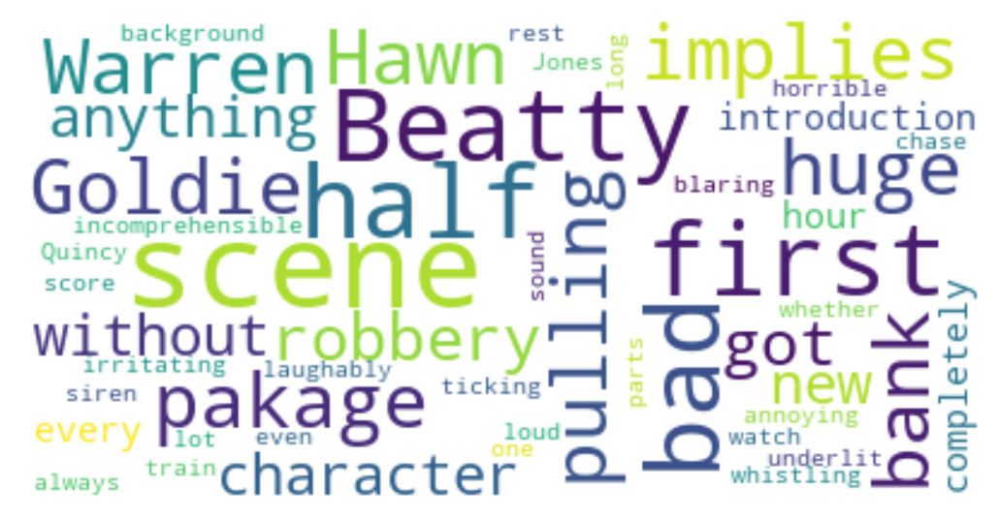

In [29]:
# initial review
text = df_reviews.review[0]
display(text)

# generation
wordcloud = WordCloud(max_font_size=50, max_words=50, background_color="white").generate(text)

# display
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [30]:
text = " ".join(review for review in df_reviews.review)
print("There are {} words in the combination of all review.".format(len(text)))

There are 61105120 words in the combination of all review.


In [31]:
# fig, axs = plt.subplots(1, 2, figsize=(12, 4))

# ax = axs[0]
dft = df_reviews.query('ds_part == "train"')['rating'].value_counts().sort_index()
dft = dft.reindex(index=np.arange(min(dft.index.min(), 1), max(dft.index.max(), 11))).fillna(0)
# dft.plot.bar(ax=ax)
# ax.set_ylim([0, 5000])
# ax.set_title('The train set: distribution of ratings')

fig = px.bar(dft, text_auto=True,labels={'rating': 'Rating Score','value': 'Count (#)'})
fig.update_layout(showlegend=False, width=1300, title='The train set: distribution of ratings')
fig.update_coloraxes(showscale=False)
fig.update_layout(xaxis={"dtick":1})

fig.show()

# ax = axs[1]
dft = df_reviews.query('ds_part == "test"')['rating'].value_counts().sort_index()
dft = dft.reindex(index=np.arange(min(dft.index.min(), 1), max(dft.index.max(), 11))).fillna(0)
# dft.plot.bar(ax=ax)
# ax.set_ylim([0, 5000])
# ax.set_title('The test set: distribution of ratings')

# fig.tight_layout()

fig = px.bar(dft, text_auto=True, labels={'rating': 'Rating Score','value': 'Count (#)'})
fig.update_layout(showlegend=False, width=1300, title='The test set: distribution of ratings')
fig.update_coloraxes(showscale=False)
fig.update_layout(xaxis={"dtick":1})

fig.show()

In [32]:
df_reviews.query('ds_part == "train"')['pos'].value_counts() # 50.1% negative

pos
0    11912
1    11884
Name: count, dtype: int64

In [33]:
df_reviews.query('ds_part == "test"')['pos'].value_counts() # 50.2% negative

pos
0    11803
1    11730
Name: count, dtype: int64

distribution of negative and positive reviews over the years for two parts of the dataset

In [35]:
# fig, axs = plt.subplots(2, 2, figsize=(16, 8), gridspec_kw=dict(width_ratios=(2, 1), height_ratios=(1, 1)))

# ax = axs[0][0]

dft = df_reviews.query('ds_part == "train"').groupby(['start_year', 'pos'])['pos'].count().unstack()
dft.index = dft.index.astype('int')
dft = dft.reindex(index=np.arange(dft.index.min(), max(dft.index.max(), 2020))).fillna(0)
# dft.plot(kind='bar', stacked=True, ax=ax)
# ax.set_title('The train set: number of reviews of different polarities per year')

# plotly
grouped_bar = px.bar(dft, title='The train set: number of reviews of different polarities per year', 
            labels={"start_year": "Year", "value": "Review Count", "pos": "Review Sentiment:"}, width=1300)

newnames = {'0':'Negative', '1': 'Positive'}
grouped_bar.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])
                                     )
                  )
grouped_bar.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

grouped_bar.show()

# ax = axs[0][1]

dft = df_reviews.query('ds_part == "train"').groupby(['tconst', 'pos'])['pos'].count().unstack()
# sns.kdeplot(dft[0], color='blue', label='negative', kernel='epa', ax=ax)
# sns.kdeplot(dft[1], color='green', label='positive', kernel='epa', ax=ax)
# ax.legend()
# ax.set_title('The train set: distribution of different polarities per movie')

# plotly
dft_train = dft.copy().dropna()

group_labels = ['Negative', 'Positive']
colors = ['blue', 'red']
fig = ff.create_distplot([dft_train[0].tolist(), dft_train[1].tolist()], group_labels,
                         #curve_type='normal', # override default 'kde'
                         colors=colors,
                         show_hist=False
                         )

fig.update_layout(height=800,
                  title='The train set: distribution of different polarities per movie',
                  showlegend=True,
                  yaxis_range=[0,0.2],  legend=dict(orientation="h",
                                                   yanchor="bottom",
                                                   y=1.02,
                                                   xanchor="right",
                                                   x=1
                  ))

fig.show()

# ax = axs[1][0]

dft = df_reviews.query('ds_part == "test"').groupby(['start_year', 'pos'])['pos'].count().unstack()
dft.index = dft.index.astype('int')
dft = dft.reindex(index=np.arange(dft.index.min(), max(dft.index.max(), 2020))).fillna(0)
# dft.plot(kind='bar', stacked=True, ax=ax)
# ax.set_title('The test set: number of reviews of different polarities per year')

# plotly
grouped_bar = px.bar(dft, title='The test set: number of reviews of different polarities per year', 
            labels={"start_year": "Year", "value": "Review Count", "pos": "Review Sentiment:"}, width=1300)

newnames = {'0':'Negative', '1': 'Positive'}
grouped_bar.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])
                                     )
                  )
grouped_bar.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

grouped_bar.show()

# ax = axs[1][1]

dft = df_reviews.query('ds_part == "test"').groupby(['tconst', 'pos'])['pos'].count().unstack()
# sns.kdeplot(dft[0], color='blue', label='negative', kernel='epa', ax=ax)
# sns.kdeplot(dft[1], color='green', label='positive', kernel='epa', ax=ax)
# ax.legend()
# ax.set_title('The test set: distribution of different polarities per movie')

# fig.tight_layout()

# plotly
dft_test = dft.copy().dropna()
fig = ff.create_distplot([dft_test[0].tolist(), dft_test[1].tolist()], group_labels,
                         #curve_type='normal', # override default 'kde'
                         colors=colors,
                         show_hist=False
                         )

fig.update_layout(height=800,
                  title='The test set: distribution of different polarities per movie',
                  showlegend=True,
                  yaxis_range=[0,0.2], legend=dict(orientation="h",
                                                   yanchor="bottom",
                                                   y=1.02,
                                                   xanchor="right",
                                                   x=1
))

fig.show()

### Findings

Visualizing our train and test set rating distributions lets us verify the expected similarities in both the distribution of ratings and the accompanying polarities.

### Evaluation Procedure
composing an evaluation routine which can be used for all models in this project

In [38]:
# plotly revision, wanted to take the time and learn how to do this via another visualization tool

import sklearn.metrics as metrics

def evaluate_model_plotly(model, train_features, train_target, test_features, test_target):
    
    eval_stats = {}
        
    for type, features, target in (('Train dataset:', train_features, train_target), ('Test dataset:', test_features, test_target)):
        
        eval_stats[type] = {}
    
        pred_target = model.predict(features)
        pred_proba = model.predict_proba(features)[:, 1]
        sub_title = '● threshold markers'

        # F1
        f1_thresholds = np.arange(0, 1.01, 0.05)
        f1_scores = [metrics.f1_score(target, pred_proba>=threshold) for threshold in f1_thresholds]
        
        # ROC
        fpr, tpr, roc_thresholds = metrics.roc_curve(target, pred_proba)
        roc_auc = metrics.roc_auc_score(target, pred_proba)    
        eval_stats[type]['ROC AUC'] = roc_auc

        # PRC
        precision, recall, pr_thresholds = metrics.precision_recall_curve(target, pred_proba)
        aps = metrics.average_precision_score(target, pred_proba)
        eval_stats[type]['APS'] = aps
        
        if type == 'train':
            color = 'blue'
        else:
            color = 'green'

        # F1 Score
        max_f1_score_idx = np.argmax(f1_scores)
        fig = px.area(x=f1_thresholds, y=f1_scores, title=f'{type} F1 (max={f1_scores[max_f1_score_idx]:.2f} @ {f1_thresholds[max_f1_score_idx]:.2f})<br><sup>{sub_title}</sup>',
                      labels=dict(x='Threshold', y='Score'),
                      width=800, height=600, markers=True, color_discrete_sequence=["blue"])        # setting crosses for some thresholds
        for threshold in (0.2, 0.4, 0.5, 0.6, 0.8):
            closest_value_idx = np.argmin(np.abs(f1_thresholds-threshold))
            marker_color = 'orange' if threshold != 0.5 else 'red'
            fig.add_traces(go.Scatter(x=pd.Series(f1_thresholds[closest_value_idx]), y=pd.Series(f1_scores[closest_value_idx]), mode="markers+text", marker=dict(color=marker_color),
                                      text=threshold, hoverinfo="skip", name='threshold markers', textposition='top center',))
        fig.update_yaxes(scaleanchor="x", scaleratio=1)
        fig.update_xaxes(constrain='domain')
        fig.update_layout(showlegend=False, title_x=0.5)
        fig.show() 
        

        # ROC
        new_line = '\n'
        fig = px.area(x=fpr, y=tpr, title=f'{type} ROC Curve (AUC={auc(fpr, tpr):.4f})<br><sup>{sub_title}</sup>',
                      labels=dict(x='False Positive Rate', y='True Positive Rate'),
                      width=800, height=600, markers=True, color_discrete_sequence=["purple"])#.add_traces(go.Scatter(x=fpr, y=tpr))
        # setting crosses for some thresholds
        for threshold in (0.2, 0.4, 0.5, 0.6, 0.8):
            closest_value_idx = np.argmin(np.abs(roc_thresholds-threshold))
            marker_color = 'orange' if threshold != 0.5 else 'red'            
            fig.add_traces(go.Scatter(x=pd.Series(fpr[closest_value_idx]), y=pd.Series(tpr[closest_value_idx]), mode="markers+text", marker=dict(color=marker_color),
                                      text=threshold, hoverinfo="skip", name='threshold markers', textposition='top left',))
        fig.add_shape(type='line', line=dict(dash='dash'), x0=0, x1=1, y0=0, y1=1)
        fig.update_yaxes(scaleanchor="x", scaleratio=1)
        fig.update_xaxes(constrain='domain')
        fig.update_layout(showlegend=False, title_x=0.5)
        fig.show()
        
        # PRC
        fig = px.area(x=recall, y=precision, title=f'{type} Precision Recall Curve (AP={aps:.2f})<br><sup>{sub_title}</sup>',
                      labels=dict(x='Recall', y='Precision'),
                      width=800, height=600, markers=True, color_discrete_sequence=["green"])
        # setting crosses for some thresholds
        for threshold in (0.2, 0.4, 0.5, 0.6, 0.8):
            closest_value_idx = np.argmin(np.abs(pr_thresholds-threshold))
            marker_color = 'orange' if threshold != 0.5 else 'red'
            fig.add_traces(go.Scatter(x=pd.Series(recall[closest_value_idx]), y=pd.Series(precision[closest_value_idx]), mode="markers+text", marker=dict(color=marker_color),
                                      text=threshold, hoverinfo="skip", name='threshold markers', textposition='top right',))
        fig.update_yaxes(scaleanchor="x", scaleratio=1)
        fig.update_xaxes(constrain='domain')
        fig.update_layout(showlegend=False, title_x=0.5)
        fig.show()        

        eval_stats[type]['Accuracy'] = metrics.accuracy_score(target, pred_target)
        eval_stats[type]['F1'] = metrics.f1_score(target, pred_target)
    
    df_eval_stats = pd.DataFrame(eval_stats)
    df_eval_stats = df_eval_stats.round(2)
    df_eval_stats = df_eval_stats.reindex(index=('Accuracy', 'F1', 'APS', 'ROC AUC'))
    
    print(df_eval_stats)
    
    return

### Normalization
assuming all models below accepts texts in lowercase and without any digits, punctuations marks etc.

In [40]:
import re

In [41]:
def normalize(review):
    pattern = r"[^a-zA-Z' ]"
    review = re.sub(pattern, '', review)
    
    return " ".join(review.split())


df_reviews['review_norm'] = df_reviews['review'].apply(normalize) # clearing text to remove digits, punctuation marks, double spacing, etc..

#### data splitting

the whole dataset is already divided into train/test one parts. The corresponding flag is 'ds_part'.

In [43]:
df_reviews_train = df_reviews.query('ds_part == "train"').copy()
df_reviews_test = df_reviews.query('ds_part == "test"').copy()

train_target = df_reviews_train['pos']
test_target = df_reviews_test['pos']

print(df_reviews_train.shape)
print(df_reviews_test.shape)

(23796, 18)
(23533, 18)


In [44]:
corpus_train = df_reviews_train['review_norm']
corpus_test = df_reviews_test['review_norm']

In [45]:
random_state = 12345 # constant random_state value to apply to all models

## Data Modeling
Model 0 - Constant

In [47]:
from sklearn.dummy import DummyClassifier

In [48]:
strategies = ['most_frequent', 'stratified', 'uniform', 'constant'] 
  
test_scores = [] 
for s in strategies: 
    if s =='constant': 
        dummy_model = DummyClassifier(strategy = s, random_state = random_state, constant = 0) 
    else: 
        dummy_model = DummyClassifier(strategy = s, random_state = random_state) 
    dummy_model.fit(corpus_train, train_target) 
    score = dummy_model.score(corpus_test, test_target) 
    test_scores.append(score)

In [49]:
# ax = sns.stripplot(strategies, test_scores); 
# ax.set(xlabel ='Strategy', ylabel ='Test Score - Negative Reviews') 
# plt.show() 

# achieved the same results while leveraging the lemmatized/transformed train/test corpus and their respective features

### Model 1 - NLTK, TF-IDF and LR

TF-IDF

In [51]:
# pip install nltk


[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: C:\Users\gsrav\Documents\car-sales-dashboard\car-sales-dashboard\venv\Scripts\python.exe -m pip install --upgrade pip


In [52]:
import nltk
# nltk.download('popular')
import subprocess

# downloading and unzipping wordnet
# try:
    # nltk.data.find('wordnet.zip')
# except:
#     nltk.download('wordnet', download_dir='/kaggle/working/')
#     command = "unzip /kaggle/working/corpora/wordnet.zip -d /kaggle/working/corpora"
#     subprocess.run(command.split())
#     nltk.data.path.append('/kaggle/working/')

# NLTK resources
from nltk.corpus import wordnet

In [53]:
nltk.download('stopwords')
# nltk.download('all-corpora')
# nltk.download('all')

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\gsrav\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [54]:
lemmatizer  = WordNetLemmatizer() 

In [55]:
def lemmatize(review):

    tokens = word_tokenize(review.lower())
    lemmas = [lemmatizer.lemmatize(token) for token in tokens]
    
    return " ".join(lemmas)

In [56]:
lr_corpus_train = corpus_train.apply(lemmatize) # applying the nltk lemmatize function to our normalized review data

lr_corpus_test = corpus_test.apply(lemmatize) # applying the nltk lemmatize function to our normalized review data

In [57]:
from spacy.lang.de.stop_words import STOP_WORDS

# stop_words = set(stopwords.words('english'))
count_tf_idf = TfidfVectorizer(stop_words = list(STOP_WORDS))

In [58]:
tf_idf = count_tf_idf.fit_transform(lr_corpus_train) # transforming our text corpus via TfidVectorizer

In [59]:
train_features_1 = tf_idf # training feature
test_features_1 = count_tf_idf.transform(lr_corpus_test) # test feature

In [60]:
model_1 = LogisticRegression(random_state=random_state)
model_1.fit(train_features_1, train_target) # model training

LogisticRegression(random_state=12345)

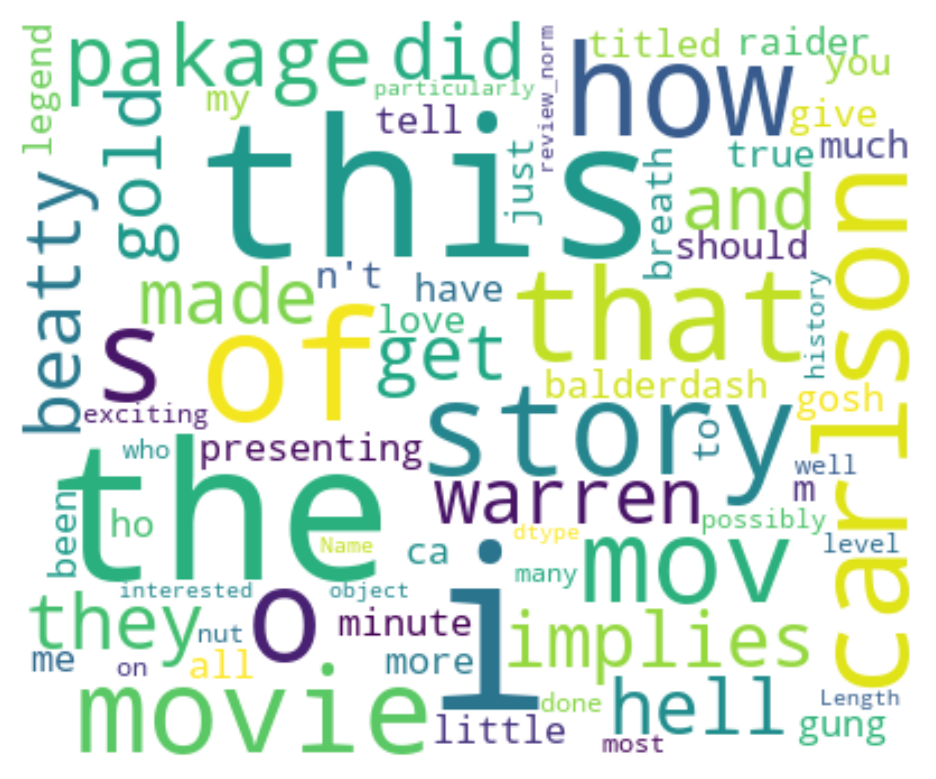

In [61]:
# model wordcloud
model_1_text = str(lr_corpus_train)

# generation
wordcloud = WordCloud(width=400, height=330, stopwords=STOP_WORDS,
                      max_font_size=100, max_words=250,
                      background_color="white", collocations=True).generate_from_text(model_1_text)

# display
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [125]:
# attempted to plot the data but the text/review length is a problem

# kmeans = KMeans(n_clusters = 5, init = 'k-means++', random_state = 0)
# kmean_indices = kmeans.fit_predict(tf_idf[0:5])

# pca = PCA(n_components=2)
# scatter_plot_points = pca.fit_transform(tf_idf[0:5].toarray())

# colors = ["r", "b", "c", "y", "m" ]

# x_axis = [o[0] for o in scatter_plot_points]
# y_axis = [o[1] for o in scatter_plot_points]
# fig, ax = plt.subplots(figsize=(20,50))

# ax.scatter(x_axis, y_axis, c=[colors[d] for d in kmean_indices])

# for i, txt in enumerate(lr_corpus_train[0:5]):
#     ax.annotate(txt, (x_axis[i], y_axis[i]))

In [63]:
# plotly conversion
evaluate_model_plotly(model_1, train_features_1, train_target, test_features_1, test_target) # model evaluation

          Train dataset:  Test dataset:
Accuracy            0.93           0.88
F1                  0.93           0.88
APS                 0.98           0.95
ROC AUC             0.98           0.95


In [64]:
model_1_predict = model_1.predict(test_features_1)

print(classification_report(test_target, model_1_predict))

              precision    recall  f1-score   support

           0       0.88      0.88      0.88     11803
           1       0.88      0.88      0.88     11730

    accuracy                           0.88     23533
   macro avg       0.88      0.88      0.88     23533
weighted avg       0.88      0.88      0.88     23533



### Model 2 - spaCy, TF-IDF and LR

In [66]:
# !python -m spacy download en_core_web_sm

In [67]:
import spacy

# Load the model with parser and NER components disabled
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

# Add the sentencizer component if not already present
if 'sentencizer' not in nlp.pipe_names:
    nlp.add_pipe('sentencizer')

In [68]:
def text_preprocessing_spacy(review):
    
    doc = nlp(review.lower())
    # tokens = [token.lemma_ for token in doc if not token.is_stop]
    lemmas = []    
    for token in doc:
        lemmas.append(token.lemma_)
    # lemmas = [token.lemma_ for token in doc if token.is_alpha and not token.is_stop]
    
    return ' '.join(lemmas)

In [69]:
lr_corpus_train_spacy = corpus_train.apply(text_preprocessing_spacy) # applying the spaCy lemmatize/processing function to our normalized review data

lr_corpus_test_spacy = corpus_test.apply(text_preprocessing_spacy) # applying the spaCy lemmatize/processing function to our normalized review data

In [126]:
count_tf_idf_2 = TfidfVectorizer(stop_words = list(STOP_WORDS))

train_features_spacy = count_tf_idf_2.fit_transform(lr_corpus_train_spacy) # 
test_features_spacy = count_tf_idf_2.transform(lr_corpus_test_spacy)

In [130]:
model_2 = LogisticRegression(random_state=random_state)
model_2.fit(train_features_spacy, train_target)

LogisticRegression(random_state=12345)

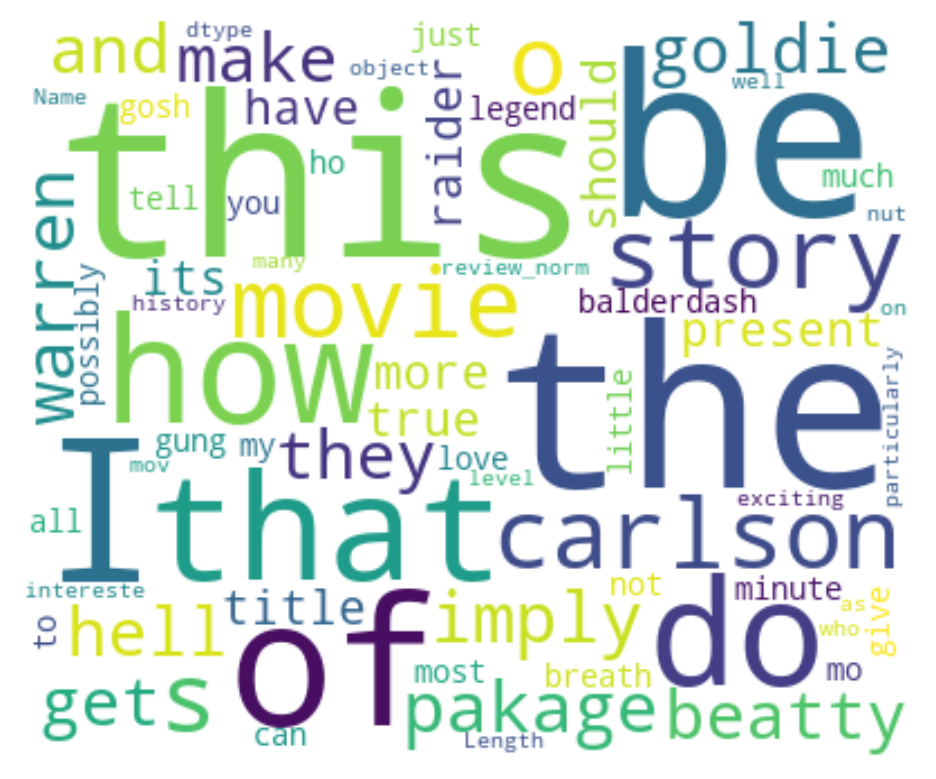

In [132]:
# model wordcloud
model_2_text = str(lr_corpus_train_spacy)

# generation
wordcloud = WordCloud(width=400, height=330, stopwords=STOP_WORDS,
                      max_font_size=100, max_words=250,
                      background_color="white", collocations=True).generate_from_text(model_2_text)

# display
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

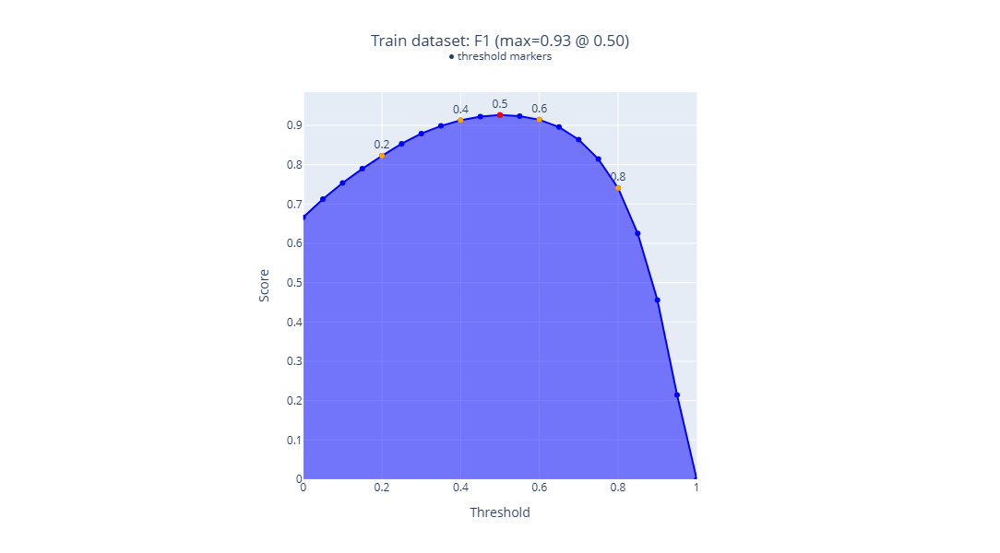

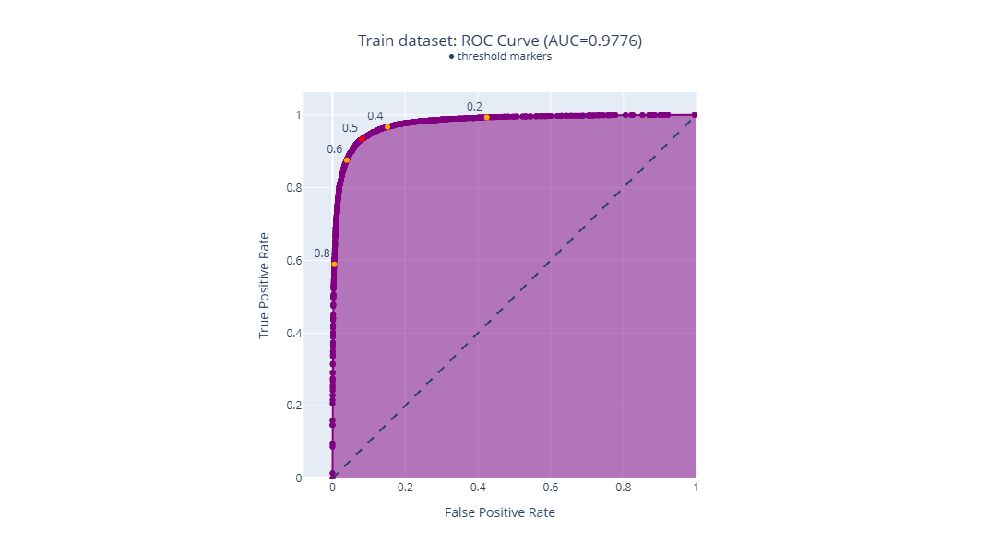

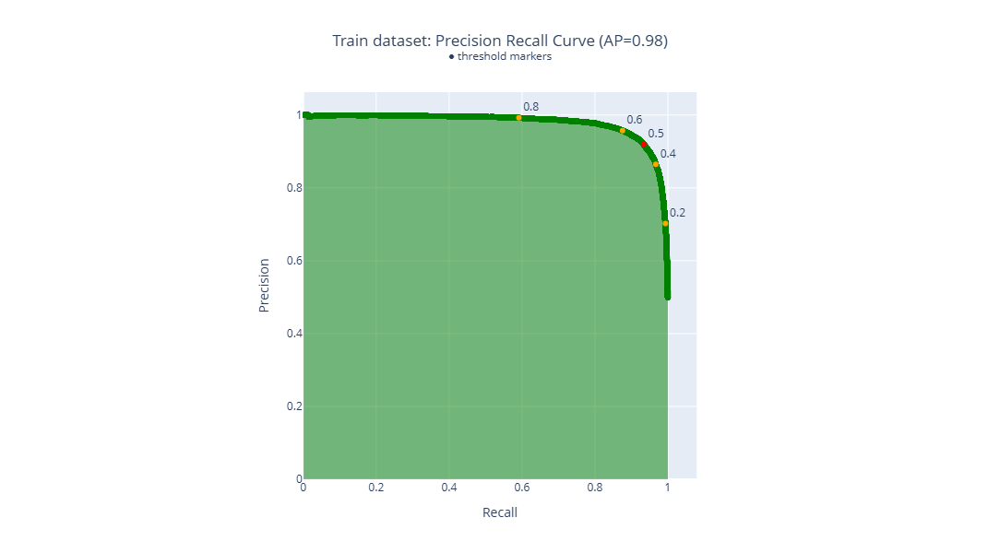

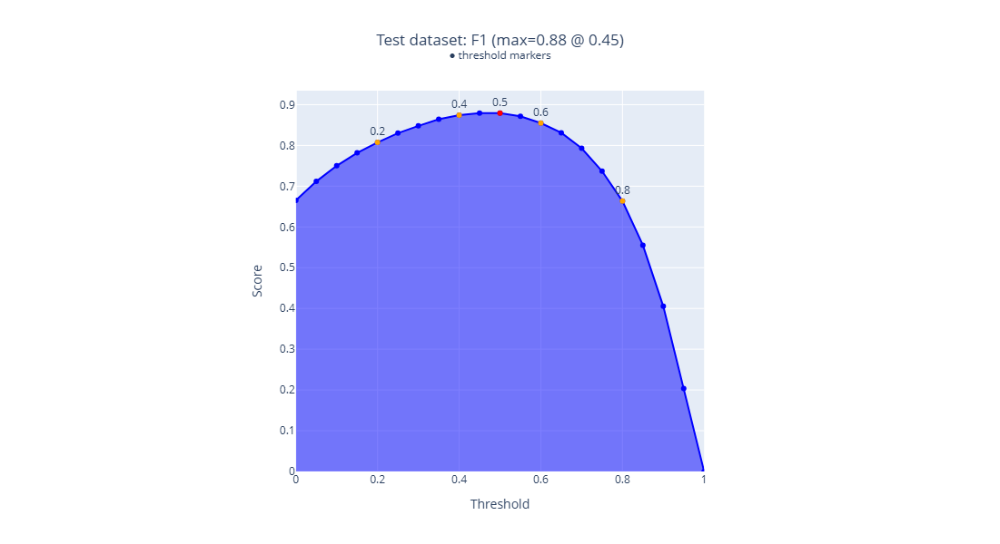

          Train dataset:  Test dataset:
Accuracy            0.93           0.88
F1                  0.93           0.88
APS                 0.98           0.95
ROC AUC             0.98           0.95


In [134]:
# evaluate_model(model_2, train_features_spacy, train_target, test_features_spacy, test_target)

# plotly conversion
evaluate_model_plotly(model_2, train_features_spacy, train_target, test_features_spacy, test_target)

In [135]:
model_2_predict = model_2.predict(test_features_spacy)

print(classification_report(test_target, model_2_predict))

              precision    recall  f1-score   support

           0       0.88      0.88      0.88     11803
           1       0.88      0.88      0.88     11730

    accuracy                           0.88     23533
   macro avg       0.88      0.88      0.88     23533
weighted avg       0.88      0.88      0.88     23533



### Model 3 - spaCy, TF-IDF and LGBMClassifier

In [147]:
# pip install lightgbm

In [145]:
from lightgbm import LGBMClassifier

In [149]:
model_3 = LGBMClassifier(random_state=random_state)
model_3.fit(train_features_spacy, train_target) # model training

[LightGBM] [Info] Number of positive: 11884, number of negative: 11912
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 1.189185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 468535
[LightGBM] [Info] Number of data points in the train set: 23796, number of used features: 9420
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499412 -> initscore=-0.002353
[LightGBM] [Info] Start training from score -0.002353


LGBMClassifier(random_state=12345)

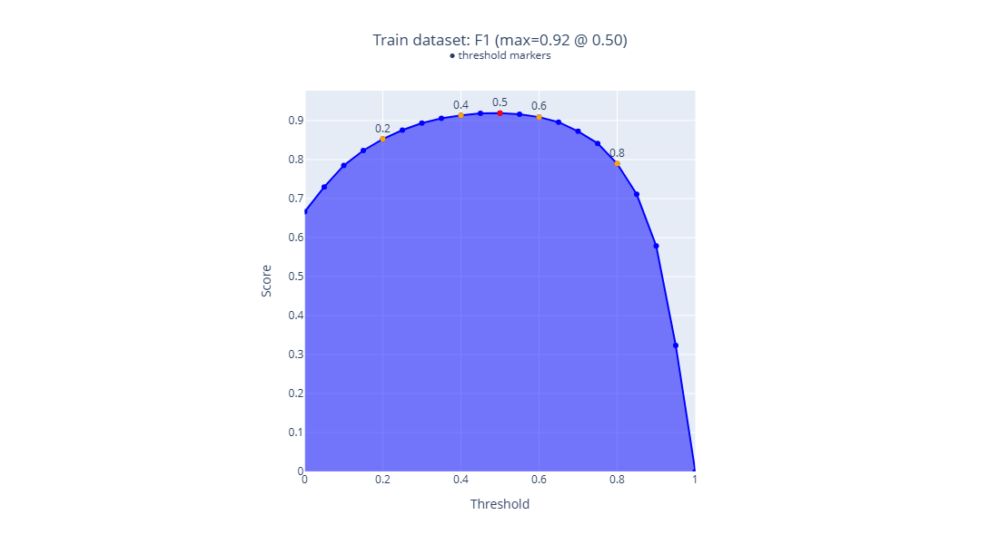

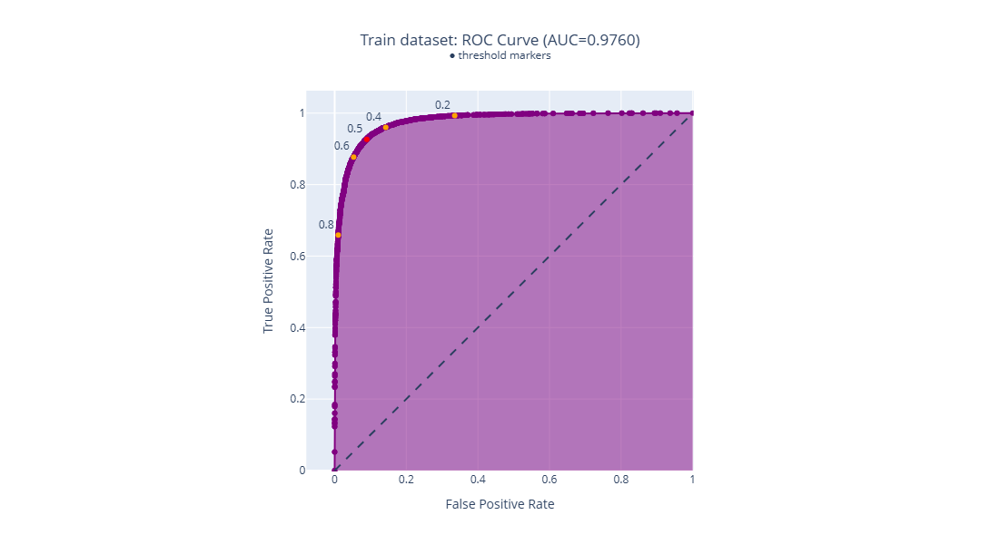

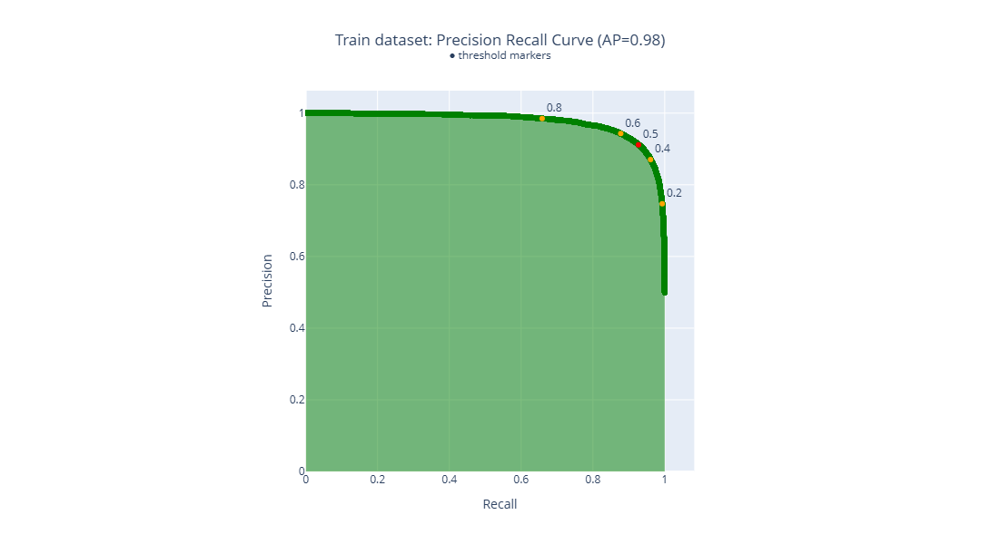

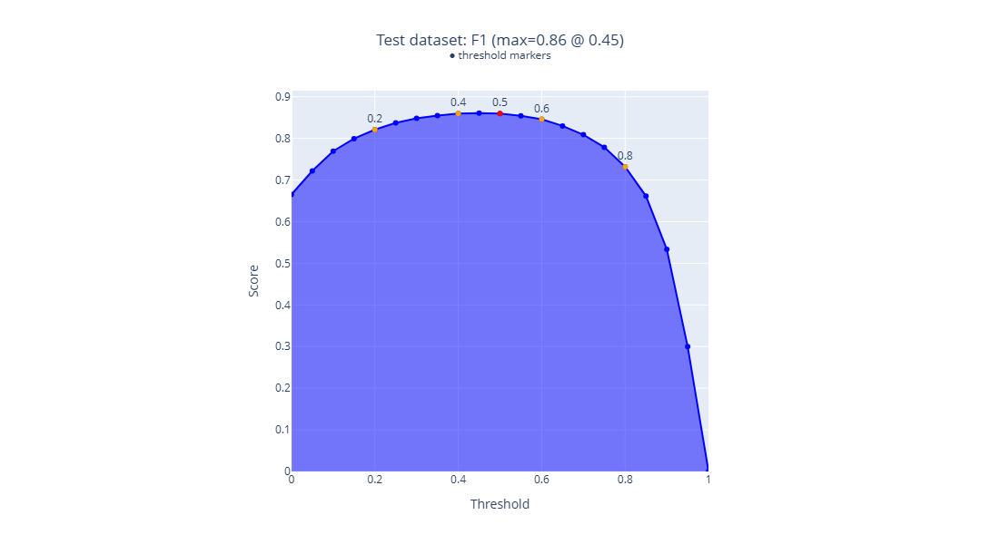

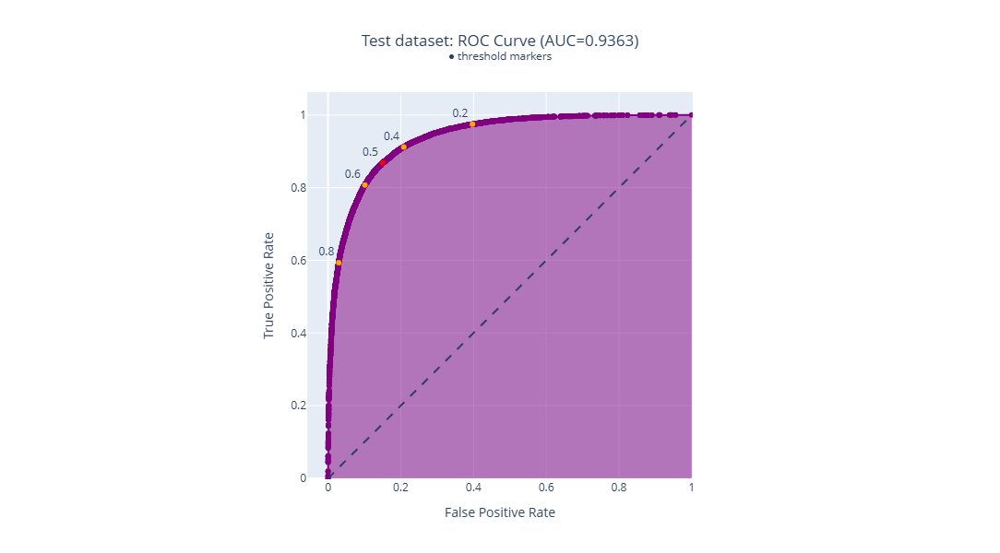

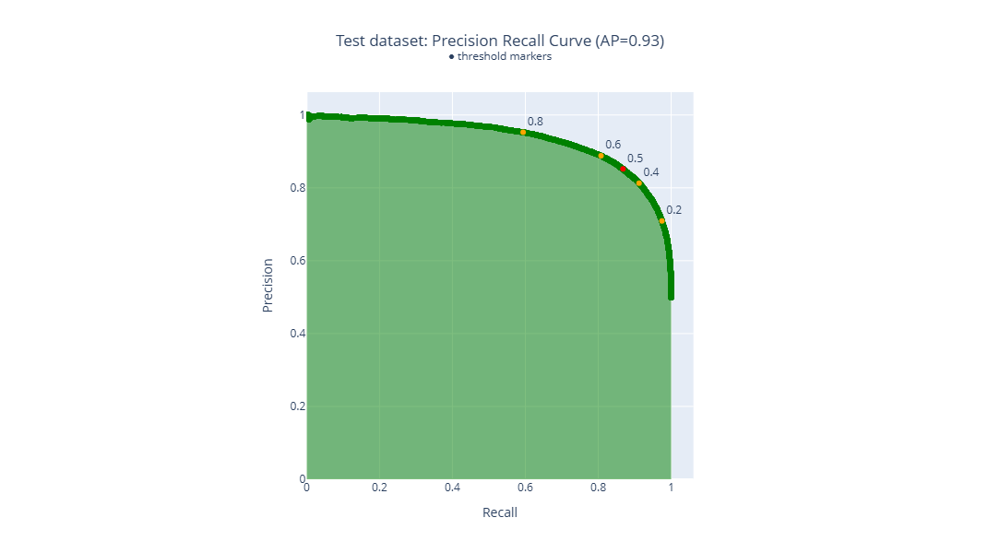

          Train dataset:  Test dataset:
Accuracy            0.92           0.86
F1                  0.92           0.86
APS                 0.98           0.93
ROC AUC             0.98           0.94


In [150]:
# evaluate_model(model_3, train_features_spacy, train_target, test_features_spacy, test_target) # evaluation

# plotly conversion
evaluate_model_plotly(model_3, train_features_spacy, train_target, test_features_spacy, test_target)

In [151]:
model_3_predict = model_3.predict(test_features_spacy)

print(classification_report(test_target, model_3_predict))

              precision    recall  f1-score   support

           0       0.87      0.85      0.86     11803
           1       0.85      0.87      0.86     11730

    accuracy                           0.86     23533
   macro avg       0.86      0.86      0.86     23533
weighted avg       0.86      0.86      0.86     23533



### BERT Model

In [156]:
# initialization based on pre-trained model
tokenizer = transformers.BertTokenizer.from_pretrained('bert-base-uncased')
config = transformers.BertConfig.from_pretrained('bert-base-uncased')
model = transformers.BertModel.from_pretrained('bert-base-uncased')

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [158]:
# checking tokenizer
example_text = "Let's see how handy transformers really are"
ids = tokenizer.encode(example_text, add_special_tokens=True)
display(ids) # numerical indices for tokens in the internal dictionary used by BERT

[101, 2292, 1005, 1055, 2156, 2129, 18801, 19081, 2428, 2024, 102]

In [160]:
def BERT_text_to_embeddings(texts, max_length=512, sample_size=1000, batch_size=25, force_device=None, disable_progress_bar=False):
    
    ids_list = []
    attention_mask_list = []

    # text to padded ids of tokens along with their attention masks
    for element in texts.iloc[:sample_size]:
        ids = tokenizer.encode(element.lower(),
                               add_special_tokens=True,
                               truncation=True,
                               max_length=max_length,
                               pad_to_max_length=True)
    
        padded = np.array(ids + [0]* (max_length - len(ids)))
        attention_mask = np.where(padded != 0, 1, 0)
        ids_list.append(padded)
        attention_mask_list.append(attention_mask)

    if force_device is not None:
        device = torch.device(force_device)
    else:
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        
    model.to(device)
    if not disable_progress_bar:
        print(f'Using the {device} device.')
    
    # gettings embeddings in batches

    embeddings = []

    for i in tqdm(range(math.ceil(len(ids_list)/batch_size)), disable=disable_progress_bar):

        # tranforming data into a tensor format
        # vectors of ids to a tensor    
        ids_batch = torch.LongTensor(
            ids_list[batch_size*i:batch_size*(i+1)]).to(device)
        # vectors of attention masks to a tensor
        attention_mask_batch = torch.LongTensor(
            attention_mask_list[batch_size*i:batch_size*(i+1)]).to(device)

        # do not need gradients     
        with torch.no_grad():            
            model.eval()
            batch_embeddings = model(input_ids=ids_batch, attention_mask=attention_mask_batch)   
        # converting elements of tensor to numpy array
        embeddings.append(batch_embeddings[0][:,0,:].detach().cpu().numpy())
        
    return np.concatenate(embeddings)

In [162]:
train_features_9 = BERT_text_to_embeddings(df_reviews_train['review_norm'])

Using the cpu device.


  0%|          | 0/40 [00:00<?, ?it/s]

C:\Users\gsrav\AppData\Local\Temp\ipykernel_64048\3957909192.py:36: UserWarning:

Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\torch\csrc\utils\tensor_new.cpp:281.)



In [163]:
print(df_reviews_train['review_norm'].shape)
print(train_features_9.shape)
print(train_target.shape)

(23796,)
(1000, 768)
(23796,)


In [166]:
test_features_9 = BERT_text_to_embeddings(df_reviews_test['review_norm'])

Using the cpu device.


  0%|          | 0/40 [00:00<?, ?it/s]

In [167]:
print(df_reviews_test['review_norm'].shape)
print(test_features_9.shape)
print(test_target.shape)

(23533,)
(1000, 768)
(23533,)


In [170]:
# if you have got the embeddings, it's advisable to save them to have them ready if 
np.savez_compressed('features_9.npz', train_features_9=train_features_9, test_features_9=test_features_9)

# and load...
with np.load('features_9.npz') as data:
    train_features_9 = data['train_features_9']
    test_features_9 = data['test_features_9']

### Logistic Regression Model (leveraging BERT)

In [173]:
max_sample_size = 1000

In [175]:
# reducing the overall size of the target Series

train_target = df_reviews_train.iloc[:max_sample_size]['pos']
test_target = df_reviews_test.iloc[:max_sample_size]['pos']

In [177]:
log_model = LogisticRegression(random_state=random_state)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=random_state)
logistic_params = [{'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga','newton-cholesky'],
                   'penalty': ['none', 'l1', 'l2'],
                   'class_weight': ['none', 'balanced'],
                   'multi_class': ['auto', 'ovr', 'multinomial'], 
                   }]
search = RandomizedSearchCV(log_model, logistic_params, scoring='f1', n_jobs=-1, cv=cv, random_state=random_state)
result = search.fit(train_features_9, train_target)
score = cross_val_score(result, train_features_9, train_target, cv=cv)

In [178]:
# print(f'Cross Val Score: {score}')
print('Best Score: %s' % result.best_score_)

Best Score: 0.8320542099813071


In [179]:
bert_predict = result.predict(test_features_9)

print(classification_report(test_target, bert_predict))

              precision    recall  f1-score   support

           0       0.80      0.84      0.82       508
           1       0.82      0.79      0.81       492

    accuracy                           0.81      1000
   macro avg       0.81      0.81      0.81      1000
weighted avg       0.81      0.81      0.81      1000



## Model application to newly introduced reviews

In [181]:
my_reviews = pd.DataFrame([
    'I did not simply like it, not my kind of movie.',
    'Well, I was bored and felt asleep in the middle of the movie.',
    'I was really fascinated with the movie',    
    'Even the actors looked really old and disinterested, and they got paid to be in the movie. What a soulless cash grab.',
    'I didn\'t expect the reboot to be so good! Writers really cared about the source material',
    'The movie had its upsides and downsides, but I feel like overall it\'s a decent flick. I could see myself going to see it again.',
    'What a rotten attempt at a comedy. Not a single joke lands, everyone acts annoying and loud, even kids won\'t like this!',
    'Launching on Netflix was a brave move & I really appreciate being able to binge on episode after episode, of this exciting intelligent new drama.'
], columns=['review'])

my_reviews['review_norm'] = my_reviews['review'].apply(normalize)

my_reviews

,review,review_norm
0,"I did not simply like it, not my kind of movie.",I did not simply like it not my kind of movie
1,"Well, I was bored and felt asleep in the middl...",Well I was bored and felt asleep in the middle...
2,I was really fascinated with the movie,I was really fascinated with the movie
3,Even the actors looked really old and disinter...,Even the actors looked really old and disinter...
4,I didn't expect the reboot to be so good! Writ...,I didn't expect the reboot to be so good Write...
5,"The movie had its upsides and downsides, but I...",The movie had its upsides and downsides but I ...
6,What a rotten attempt at a comedy. Not a singl...,What a rotten attempt at a comedy Not a single...
7,Launching on Netflix was a brave move & I real...,Launching on Netflix was a brave move I really...


### Model 1

In [183]:
texts = my_reviews['review_norm']

my_reviews_pred_prob = model_1.predict_proba(count_tf_idf.transform(texts))[:, 1]

for i, review in enumerate(texts.str.slice(0, 100)):
    print(f'{my_reviews_pred_prob[i]:.2f}:  {review}')

0.14:  I did not simply like it not my kind of movie
0.30:  Well I was bored and felt asleep in the middle of the movie
0.59:  I was really fascinated with the movie
0.21:  Even the actors looked really old and disinterested and they got paid to be in the movie What a soul
0.36:  I didn't expect the reboot to be so good Writers really cared about the source material
0.61:  The movie had its upsides and downsides but I feel like overall it's a decent flick I could see myse
0.10:  What a rotten attempt at a comedy Not a single joke lands everyone acts annoying and loud even kids 
0.84:  Launching on Netflix was a brave move I really appreciate being able to binge on episode after episo


### Model 2

In [190]:
texts = my_reviews['review_norm']

my_reviews_pred_prob = model_2.predict_proba(count_tf_idf_2.transform(texts.apply(lambda x: text_preprocessing_spacy(x))))[:, 1]

for i, review in enumerate(texts.str.slice(0, 100)):
    print(f'{my_reviews_pred_prob[i]:.2f}:  {review}')

0.16:  I did not simply like it not my kind of movie
0.22:  Well I was bored and felt asleep in the middle of the movie
0.62:  I was really fascinated with the movie
0.19:  Even the actors looked really old and disinterested and they got paid to be in the movie What a soul
0.20:  I didn't expect the reboot to be so good Writers really cared about the source material
0.68:  The movie had its upsides and downsides but I feel like overall it's a decent flick I could see myse
0.02:  What a rotten attempt at a comedy Not a single joke lands everyone acts annoying and loud even kids 
0.87:  Launching on Netflix was a brave move I really appreciate being able to binge on episode after episo


### Model 3

In [193]:
texts = my_reviews['review_norm']

tfidf_vectorizer_3 = count_tf_idf_2
my_reviews_pred_prob = model_3.predict_proba(tfidf_vectorizer_3.transform(texts.apply(lambda x: text_preprocessing_spacy(x))))[:, 1]

for i, review in enumerate(texts.str.slice(0, 100)):
    print(f'{my_reviews_pred_prob[i]:.2f}:  {review}')

0.56:  I did not simply like it not my kind of movie
0.53:  Well I was bored and felt asleep in the middle of the movie
0.64:  I was really fascinated with the movie
0.61:  Even the actors looked really old and disinterested and they got paid to be in the movie What a soul
0.49:  I didn't expect the reboot to be so good Writers really cared about the source material
0.79:  The movie had its upsides and downsides but I feel like overall it's a decent flick I could see myse
0.17:  What a rotten attempt at a comedy Not a single joke lands everyone acts annoying and loud even kids 
0.77:  Launching on Netflix was a brave move I really appreciate being able to binge on episode after episo


### BERT Model

In [196]:
texts = my_reviews['review_norm']

my_reviews_features_9 = BERT_text_to_embeddings(texts, disable_progress_bar=True)

my_reviews_pred_prob = result.predict_proba(my_reviews_features_9)[:, 1]

for i, review in enumerate(texts.str.slice(0, 100)):
    print(f'{my_reviews_pred_prob[i]:.2f}:  {review}')

0.26:  I did not simply like it not my kind of movie
0.03:  Well I was bored and felt asleep in the middle of the movie
0.89:  I was really fascinated with the movie
0.00:  Even the actors looked really old and disinterested and they got paid to be in the movie What a soul
0.42:  I didn't expect the reboot to be so good Writers really cared about the source material
0.95:  The movie had its upsides and downsides but I feel like overall it's a decent flick I could see myse
0.01:  What a rotten attempt at a comedy Not a single joke lands everyone acts annoying and loud even kids 
0.90:  Launching on Netflix was a brave move I really appreciate being able to binge on episode after episo


## Conclusions

### General

We initialized a DataFrame with more than 40k+ rows and 15+ colums (plenty with varying dtypes). Given our goal was to apply ML on a set of reviews (IMDB in this instance), a large set of columns were set aside and the main focus was on three specific ones:

review: the review text

pos: the target, '0' for negative and '1' for positive

ds_part: 'train'/'test' for the train/test part of dataset, correspondingly

Through our typical usage of EDA along with deep visualizations, we were able to get a sense of the data structure (mainly our targets and any imbalancing) along with some additional insights (frequency of reviews per movie). We were able to construct an intial view on the polarity of our target and the distribution of ratings. At first glance, this DataFrame did not have many 'errors' or clean-up requirements (aside from a minor number of N/A values, which were removed given the count; 2 or 3 rows which have no real impact in this exercise).

### Model Training/Evaluations

Before initializing our models, we start by defining the way we are to 'normalize' our features (reviews) with the removal of digits, punctuations marks and other things of the sort. This initial clean up sets the stage for us to split the data and create the required train/test text corpus later used in our modeling.

We created a dummy model in order to have something to benchmark against and make sure our LR/LBGM models were up to par (better than our dummy).

Through the use of tokenization and lemmatization via NLTK and spaCy, our achieved F1 scores throughout the 3 models is above our target value of 0.85. The model with the highest F1 score was our LinearRegression model that used both NLTK and spaCy processing for the tokenization/lemmatization of our review corpus. Scores were as follows:

LR + NLTK: 0.88

LR + spaCy: 0.88

LGBM + spaCy: 0.86

BERT: 0.75 (limited to 200 samples) / 0.81 (500 samples) / 0.81 (1000 samples)

We were able to achieve all of these scores without the need to tune or search for the optimial hyperparameters.

For the BERT model, we chose to run a RandomizedSearchCV to try and find optimal hyperparameters and tune accordingly, the results weren't as good as the other scenarios when we limit the sample size (as expected). Once that was increased, we saw better F1 results (to a certain point). Note: increasing the batch size considerably impacts performance and cripples the cpu in this instance.

### Classification of Newly Introduced Reviews

Leveraging our previously created tokenization/lemmatization functions as well as our previously trained models based on a 'train' text corpus, we created our own set of reviews for further model evaluation. This is displayed using the same 'fake' set of reviews through three variations where we compared the probability based on each row/review (probability of a negative vs positive review).

Based on our results, we see similarities throughout. For instance, our second to last row with the word 'rotten' get a particular bad proability of being a positive score which makes sense given we associate any instance of the word with a negative review. The probability values through the three evaluations match, this row/review is the lowest value of them all.

At the opposite spectrum, the same can be said of the last row/review, where we see words like 'brave' and 'appreciate' or 'binge' which we can usually associate with a possitive tone. All three evaluations give us a similar value, the highest out of the bunch. With that said, there is some variability on the probability value 'ranking' though the middle rows/reviews, although not very significant. Most likely due to 1) the overall differences between NLTK and spaCy and 2) our use of LGBM for our last evaluation.

Lastly, BERT seems to have stronger classification affinity as any negative word considerably pushes the probability scale to the approriate 'bin' and vice-versa.